In [1]:
import pandas as pd
import numpy as np
import seaborn as sns
import matplotlib.pyplot as plt
import datetime

In [2]:
covid_train_df = pd.read_csv('./covid_train_tratado.csv')
covid_test_df = pd.read_csv('./covid_test_tratado.csv')

In [3]:
covid_train_df.shape, covid_test_df.shape

((969640, 7), (311670, 6))

In [4]:
covid_train_df.head()

,Unnamed: 0,Country_Region,Population,Weight,Date,Target,TargetValue
0,0,Afghanistan,27657145,0.058359,2020-01-23,ConfirmedCases,0
1,1,Afghanistan,27657145,0.583587,2020-01-23,Fatalities,0
2,2,Afghanistan,27657145,0.058359,2020-01-24,ConfirmedCases,0
3,3,Afghanistan,27657145,0.583587,2020-01-24,Fatalities,0
4,4,Afghanistan,27657145,0.058359,2020-01-25,ConfirmedCases,0


In [5]:
covid_test_df.head()

,Unnamed: 0,Country_Region,Population,Weight,Date,Target
0,0,Afghanistan,27657145,0.058359,2020-04-27,ConfirmedCases
1,1,Afghanistan,27657145,0.583587,2020-04-27,Fatalities
2,2,Afghanistan,27657145,0.058359,2020-04-28,ConfirmedCases
3,3,Afghanistan,27657145,0.583587,2020-04-28,Fatalities
4,4,Afghanistan,27657145,0.058359,2020-04-29,ConfirmedCases


In [6]:
covid_train_df.drop(['Unnamed: 0'], axis = 1, inplace=True)
covid_test_df.drop(['Unnamed: 0'], axis = 1, inplace=True)

# ANALISE DE DADOS

In [7]:
import plotly.express as px

In [8]:
fig = plt.figure(figsize=(40,30))
fig = px.pie(covid_train_df, values='TargetValue', names='Country_Region').update_traces(textposition = 'inside')
fig.show()

<Figure size 4000x3000 with 0 Axes>

In [9]:
c_region = covid_train_df.groupby('Country_Region').sum()
c_region_top = c_region.nlargest(10, 'Population')['TargetValue']
c_region_top

Country_Region
China          176564
India          284328
US            6317214
Indonesia       36275
Brazil         812096
Pakistan       115957
Nigeria         14255
Bangladesh      75877
Russia         499373
Japan           18066
Name: TargetValue, dtype: int64

In [10]:
px.bar(x = c_region_top.index,y= c_region_top.values, labels=dict(x='Region',y='Casos de covid'))

In [11]:
covid_train_df['Date']= pd.to_datetime(covid_train_df['Date'])
covid_test_df['Date']= pd.to_datetime(covid_test_df['Date'])

<AxesSubplot:xlabel='Date'>

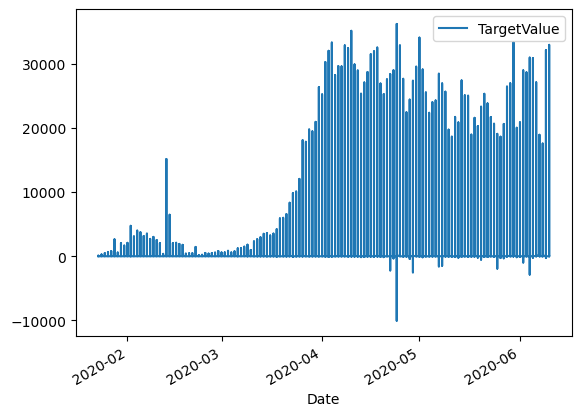

In [12]:
covid_train_df.plot.line(x='Date', y='TargetValue')

In [13]:
def country_Region(region):
    df_conf = covid_train_df.loc[(covid_train_df['Country_Region'] == region) & (covid_train_df['Target'] == 'ConfirmedCases')]    
    df_fata = covid_train_df.loc[(covid_train_df['Country_Region'] == region) & (covid_train_df['Target'] == 'Fatalities')]    
    df_conf.plot.line(x='Date', y='TargetValue')
    df_fata.plot.line(x='Date', y='TargetValue', color='r')

    return df_conf, df_fata

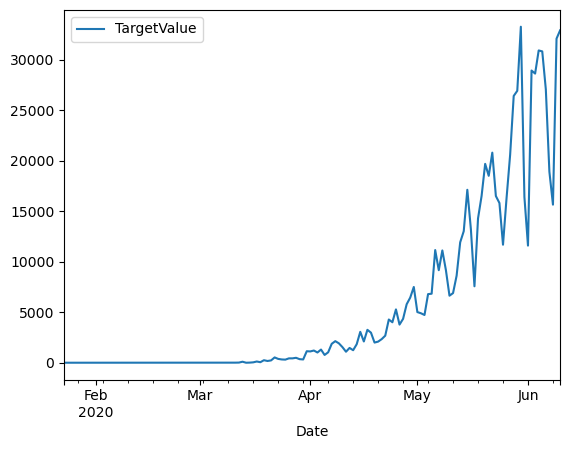

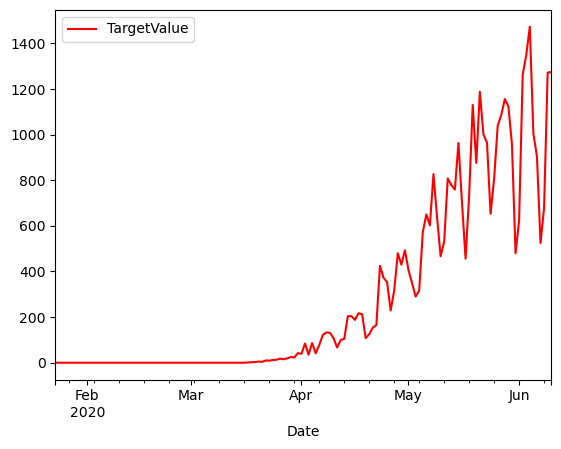

In [14]:
df_conf, df_fata = country_Region('Brazil')